In [1]:
import os
import numpy as np
import pandas as pd
from torch.utils.data import Dataset, DataLoader
from torchvision.transforms import Compose, Normalize
import torch
from torchsummary import summary

from sklearn.model_selection import train_test_split, StratifiedKFold
import random
from PIL import Image
import cv2
import rasterio as rio
import matplotlib.pyplot as plt
import time
from tqdm import tqdm
import csv

import matplotlib.pyplot as plt
plt.rcParams.update({
    'axes.titlesize': 14,    # Font size for plot titles
    'axes.labelsize': 12,    # Font size for x and y labels
    'xtick.labelsize': 10,   # Font size for x tick labels
    'ytick.labelsize': 10,   # Font size for y tick labels
    'legend.fontsize': 12,   # Font size for the legend
    'font.size': 12     ,     # Default font size
    'font.family': 'serif',
})

## 1. Raw data visualization

In [2]:
data_path = r"E:\Thesis\data\toy\l1c\train"
meta_path =  r"E:\Thesis\data\toy\meta_patches.csv"
metadata = pd.read_csv(meta_path)

In [25]:
# loss = torch.nn.CrossEntropyLoss()
# optimiser = torch.optim.Adam
# str(optimiser)

"<class 'torch.optim.adam.Adam'>"

In [3]:
metadata.head(5)

,patch_id,set,learn_type,lon,lat,date,climate,biome_str,biome_id,eco_str,eco_id,country,continent,origin_name,s2_gee_id,s2_l1c_id,s2_l2a_id
0,21.1424_36.6557-20170519,train,ssl,21.1424,36.6557,20170519,Ocean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20170519T092031_20170519T092900_T34SEF,S2A_MSIL1C_20170519T092031_N0205_R093_T34SEF_2...,S2A_MSIL2A_20170519T092031_N0205_R093_T34SEF_2...
1,27.6165_38.8065-20170702,train,ssl,27.6165,38.8065,20170702,Csa,"Mediterranean Forests, Woodlands & Scrub",12.0,Aegean and Western Turkey sclerophyllous and m...,785.0,Turkey,Asia,NaN,20170702T085641_20170702T090524_T35SND,S2A_MSIL1C_20170702T085641_N0205_R007_T35SND_2...,S2A_MSIL2A_20170702T085641_N0205_R007_T35SND_2...
2,4.3601_44.7555-20170821,train,ssl,4.3601,44.7555,20170821,Cfb,Temperate Broadleaf & Mixed Forests,4.0,Western European broadleaf forests,686.0,France,Europe,NaN,20170821T104021_20170821T104208_T31TFK,S2A_MSIL1C_20170821T104021_N0205_R008_T31TFK_2...,S2A_MSIL2A_20170821T104021_N0205_R008_T31TFK_2...
3,35.1817_31.3179-20171217,train,ssl,35.1817,31.3179,20171217,BSh,Deserts & Xeric Shrublands,13.0,Mesopotamian shrub desert,830.0,Israel,Asia,NaN,20171217T082341_20171217T082801_T36RYV,S2A_MSIL1C_20171217T082341_N0206_R121_T36RYV_2...,S2A_MSIL2A_20171217T082341_N0206_R121_T36RYV_2...
4,-117.2887_33.1499-20181215,test,csl,-117.2887,33.1499,20181215,BSk,"Mediterranean Forests, Woodlands & Scrub",12.0,California coastal sage and chaparral,422.0,United States of America,North America,dw_-117.2887333221_33.1498984125-20181215_cons...,20181215T183751_20181215T184316_T11SMS,S2A_MSIL1C_20181215T183751_N0207_R027_T11SMS_2...,S2A_MSIL2A_20181215T183751_N0211_R027_T11SMS_2...


In [4]:
class TestClass(Dataset):
    def __init__(self, data_path, metadata, set, learn_type, process_level, transform=None):
    # in metadata dataframe, select patches with set as train 
        self.data_path = data_path
        self.metadata = metadata
        self.set = set
        self.transform = transform
        self.process_level = process_level
        self.learn_type = learn_type

    def __len__(self):
        return len(self.metadata[(self.metadata['set']==self.set) & (self.metadata['learn_type']==self.learn_type)])

    def __getitem__(self, idx):
        # return tensor pair feature,label
        # read image
        metadata_set = self.metadata[(self.metadata['set']==self.set) & (self.metadata['learn_type']==self.learn_type)]
        feat_fname= (f"{self.process_level}_"
                      f"{self.learn_type}_"
                      f"{metadata_set.iloc[idx, 0]}_"
                      f"feats.tif")
        label_fname= (f"{self.process_level}_"
                      f"{self.learn_type}_"
                      f"{metadata_set.iloc[idx, 0]}_"
                      f"label.tif")

        feat_p = os.path.join(self.data_path, feat_fname)
        label_p = os.path.join(self.data_path, label_fname)
        
        with rio.open(feat_p) as src:
            feat = src.read().astype(np.int16)
        with rio.open(label_p) as src:
            label = src.read().astype(np.int16)

        # handle dtypes for tensor
        feat = torch.from_numpy(feat).to(torch.int16)
        label = torch.from_numpy(label).to(torch.int16)
        # if self.transform:
        #     feat = self.transform(feat)
            # label = self.transform(label)
        return feat, label

In [3]:
class SiamDW_DataClass(Dataset):
    def __init__(self, data_path, metadata, set, learn_type, process_level, input_type, lis_patch_ids = None, feat_transform=None, label_transform = None):
    # in metadata dataframe, select patches with set as train 
        self.data_path = data_path
        self.set = set
        self.process_level = process_level
        self.learn_type = learn_type
        self.input_type = input_type
        self.metadata = metadata
        self.feat_transform = feat_transform
        self.label_transform = label_transform

        # subset based on set (train/test) and learn_type (csl/ssl)
        self.metadata_set = self.metadata[(self.metadata['set']==self.set) & (self.metadata['learn_type']==self.learn_type)]
        
        # subset again if list of patch_ids is given - this will be used during training for implementing stratified kfold
        if lis_patch_ids is not None:
            self.metadata_set = self.metadata_set[self.metadata_set['patch_id'].isin(lis_patch_ids)]

    def __len__(self):
        return len(self.metadata_set)

    def __getitem__(self, idx):

        # Load label
        label_fname= (f"{self.process_level}_"
                f"{self.learn_type}_"
                f"{self.metadata_set.iloc[idx, 0]}_"
                f"label.tif")
        label_p = os.path.join(self.data_path, label_fname)
        with rio.open(label_p) as src:
            label = src.read().astype(np.int16)

        # Load feature (based on input type)
        if self.input_type == 's2':                 # multipsectral input
            feat_fname= (f"{self.process_level}_"
                        f"{self.learn_type}_"
                        f"{self.metadata_set.iloc[idx, 0]}_"
                        f"feats.tif")
            feat_p = os.path.join(self.data_path, feat_fname)
            with rio.open(feat_p) as src:
                feat = src.read().astype(np.int16)
       
        elif 'siam' in self.input_type:             # siam input
            feat = self.convert_to_rgb(label, self.input_type)

        # Convert to torch tensors of type float32
        feat = torch.from_numpy(feat).to(torch.float32)
        label = torch.from_numpy(label).to(torch.float32)

        # move up 255 to a value after max of the granularity, subtract 1 from last 4 bands i.e. siam bands of label to make it 0-indexed
        if self.learn_type == 'ssl':
            #set 255 to value after max value in the band
            label[1]=torch.where(label[1]==255, 19, label[1])
            label[2]=torch.where(label[2]==255, 34, label[2])
            label[3]=torch.where(label[3]==255, 49, label[3])
            label[4]=torch.where(label[4]==255, 97, label[4])
            label[1:] = label[1:] - 1
        
        if self.feat_transform is not None: 
            feat = self.feat_transform(feat)     
        if self.label_transform is not None:
            label = self.label_transform(label)    # for padding 

        return feat, label.long(), self.metadata_set.iloc[idx, 0] #get the patch id to save results
    
    def read_legend(self, legend_path):
        with open(legend_path, mode='r') as file:
            reader = csv.DictReader(file, delimiter=',')  
            rgb_dict = {}
            for row in reader:
                #print(row)
                value = int(row['value'])
                rgb = tuple(map(int, row['rgb'][1:-1].split(',')))  # Convert "(r, g, b)" string to tuple
                rgb_dict[value] = rgb
        return rgb_dict
    
    def convert_to_rgb(self, label, input_type):
        #path to legend csv
        file_name = 'lgd_' + input_type + '.csv'
        legend_path = os.path.split(os.path.split(self.data_path)[0])[0] # remove last two levels of path to get to the data folder
        legend_path = os.path.join(legend_path, 'legends',file_name)
        rgb_dict = self.read_legend(legend_path) # this returns a dictionary with class values as keys and rgb values as tuples
        rgb_image = np.zeros((3, label.shape[1], label.shape[2]), dtype=np.uint8)

        # band 0 is scl, band 1 in label is siam_18, band 2 is siam_33, band 3 is siam_48, band 4 is siam_96
        if input_type == 'siam_18':
            band = 1
        elif input_type == 'siam_33':
            band = 2
        elif input_type == 'siam_48':
            band = 3
        elif input_type == 'siam_96':
            band = 4
        
        # Create RGB image by assigning values to the image based on the tensor values of the siam band of interest
        for value, rgb in rgb_dict.items():
            rgb_image[0, label[band] == value] = rgb[0]
            rgb_image[1, label[band] == value] = rgb[1]
            rgb_image[2, label[band] == value] = rgb[2]

        return rgb_image

class NormalizeImage:

    def __init__(self, input_type):
        super(NormalizeImage, self).__init__()
        self.input_type = input_type
        
    def __call__(self, image):
        if self.input_type == 's2':
            return self.normalize_s2(image)
        elif 'siam' in self.input_type:
            return self.normalize_siam(image)
        
    def normalize_s2(self, image):
        # Normalize image to the 1st and 99th percentile
        num_bands, _, _ = image.shape
        flattened_image = image.view(num_bands, -1)

        # Calculate the 1st and 99th percentile along the band dimension
        min_percentiles = torch.kthvalue(flattened_image, int(flattened_image.size(1) * 0.01), dim=1).values
        max_percentiles = torch.kthvalue(flattened_image, int(flattened_image.size(1) * 0.99), dim=1).values

        # Reshape percentiles to have shape (num_bands, 1, 1). This is necessary for element-wise operations
        min_percentiles = min_percentiles[:, None, None]
        max_percentiles = max_percentiles[:, None, None]

        # Clip image values to the range defined by percentiles
        normalized_image = torch.clamp((image - min_percentiles) / (max_percentiles - min_percentiles), 0, 1)
        return normalized_image
    
    def normalize_siam(self, image):
        # divide all three bands by 255
        normalized_image = image/255.0
        return normalized_image

class Padding:
    def __init__(self, output_size=(512, 512)):
        self.output_size = output_size

    def __call__(self, image):
        _, h, w = image.shape
        new_h, new_w = self.output_size

        top_pad = (new_h - h) // 2
        bottom_pad = new_h - h - top_pad
        left_pad = (new_w - w) // 2
        right_pad = new_w - w - left_pad

        padded_image = torch.nn.functional.pad(image, (left_pad, right_pad, top_pad, bottom_pad))
        return padded_image

#### Preliminary

In [10]:
for i in data:
    print(i[0].shape, i[1].shape)
    break   

torch.Size([4, 10, 510, 510]) torch.Size([4, 6, 510, 510])


In [5]:
batch_size = 4
dataset = TestClass(data_path, metadata, 'train', 'csl','l1c')
data = DataLoader(dataset, batch_size=batch_size, shuffle=False, drop_last=True) # make shuffle true while training

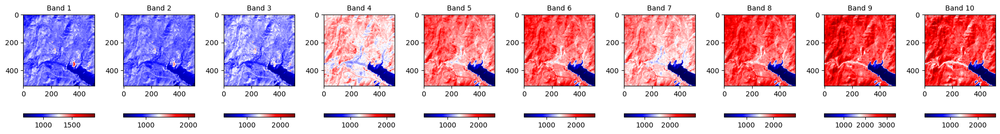

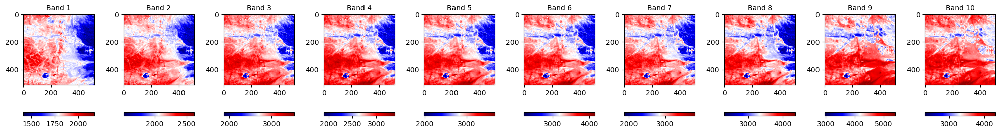

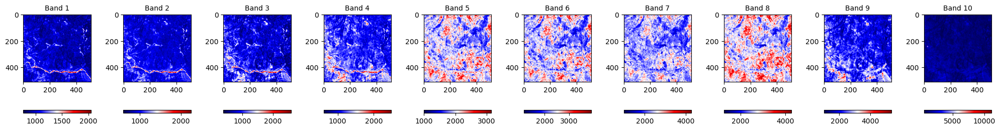

In [21]:
def visualize_data(data, random_seed=42, batch_thresh = 3):
    for batch_num, batch in enumerate(data):
        features, _ = batch
        num_bands = features.shape[1]
        
        # plot feature and label images
        fig, axes = plt.subplots(1,num_bands , figsize=(20, 4))

        # randomly choose an image,label set to display
        np.random.seed(random_seed)
        idx = np.random.choice(features.shape[0])
        for i in range(num_bands):
  
            im =axes[i].imshow(features[idx][i,:,:], cmap='seismic')
            #axes[i].set_title(feature_names[i], fontsize=10)
            axes[i].set_title(f"Band {i+1}", fontsize=10)
            sm = plt.cm.ScalarMappable(cmap='seismic')
            sm.set_array(features[idx][i,:, :])
            cbar = fig.colorbar(im, ax=axes[i], orientation = 'horizontal')

        plt.tight_layout()
        plt.show()

        if batch_num == batch_thresh:
            break

visualize_data(data, random_seed =46, batch_thresh = 3)

#### Input = Multispectral

In [ ]:
batch_size = 4
input_type = 's2'
learn_type = 'csl'
dataset = SiamDW_DataClass(data_path, metadata, 'train', learn_type, 'l1c', input_type, 
                           feat_transform=NormalizeImage(input_type))
data = DataLoader(dataset, batch_size=batch_size, shuffle=False)

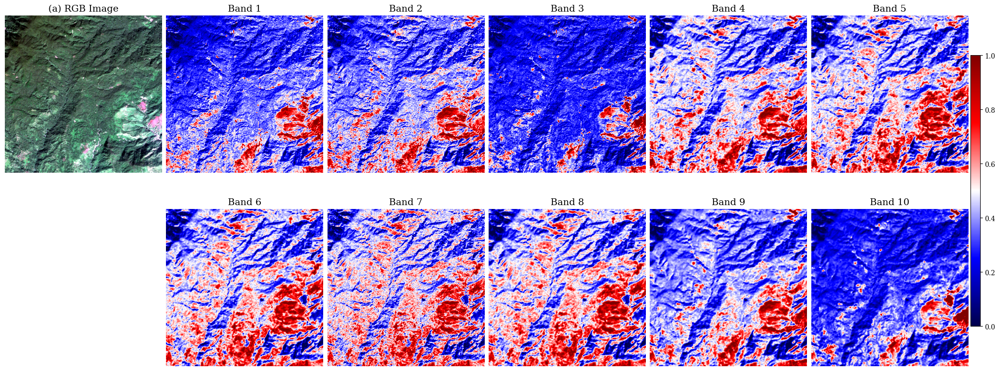

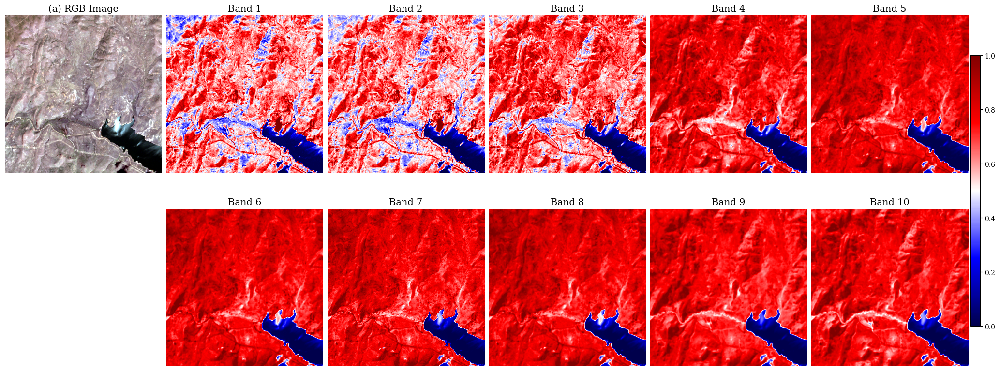

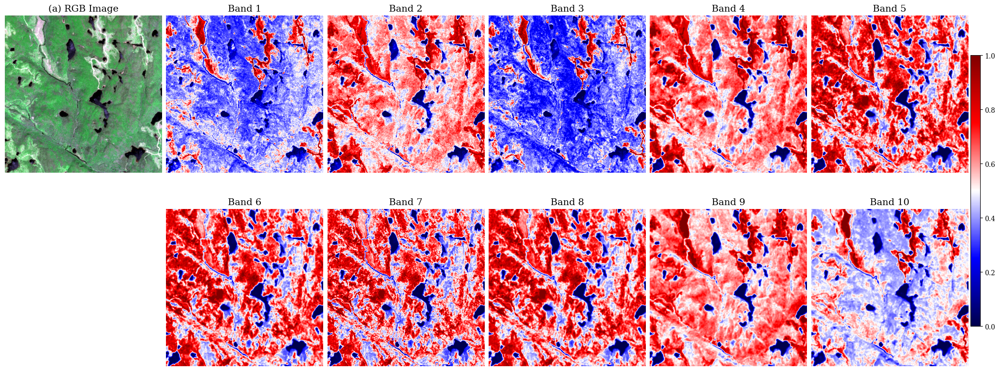

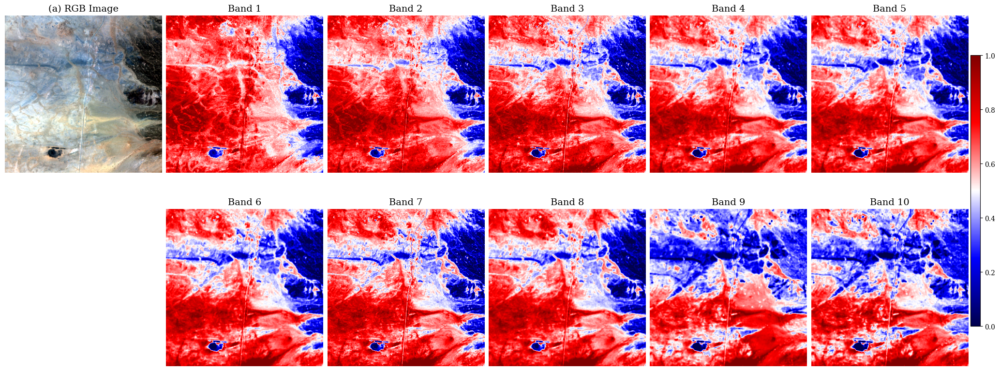

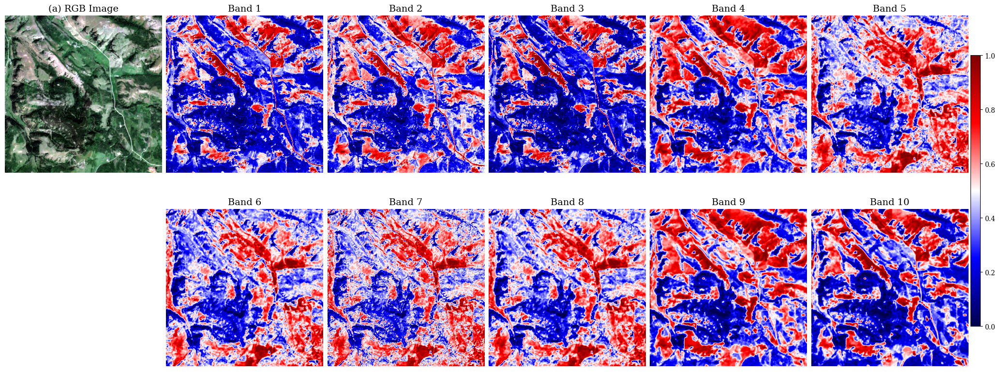

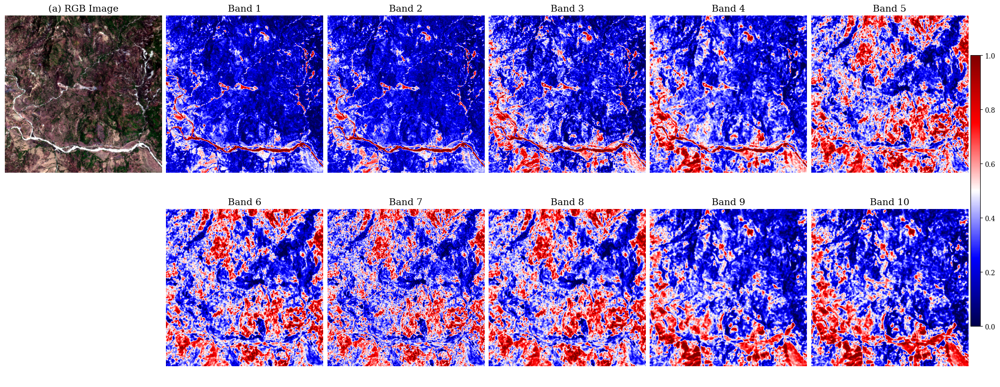

In [61]:
import numpy as np
import matplotlib.pyplot as plt

def visualize_data_v2(data, random_seed=42, batch_thresh=3):
    for batch_num, batch in enumerate(data):
        # if batch_num != batch_thresh:
        #     continue
        features, _, p_id = batch
        num_bands = features.shape[1]
        
        # Determine the layout for the subplots
        num_columns = (num_bands + 2) // 2  # Adding 2 for RGB image and distributing evenly
        
        fig, axes = plt.subplots(2, num_columns, figsize=(20, 8), constrained_layout=True)
        
        # Flatten axes array for easy iteration
        axes = axes.flatten()
        
        # randomly choose an image, label set to display
        np.random.seed(random_seed)
        idx = np.random.choice(features.shape[0])
        
        # Plot RGB image using bands 1, 2, 3 in the first subplot
        rgb_image = np.stack((features[idx][2], features[idx][1], features[idx][0]), axis=-1)
        axes[0].imshow(rgb_image)
        axes[0].set_title('(a) RGB Image', fontsize=14)
        
        # Plot all bands including bands 1, 2, 3 individually
        for i in range(num_bands):
            if i + 1 < num_columns:  # First row
                im = axes[i + 1].imshow(features[idx][i,:,:], cmap='seismic')
                axes[i + 1].set_title(f"Band {i+1}", fontsize=14)
            else:  # Second row
                im = axes[i + 2].imshow(features[idx][i,:,:], cmap='seismic')
                axes[i + 2].set_title(f"Band {i+1}", fontsize=14)
        
        # mute x y labels, ticks
        for ax in axes:
            ax.axis('off')
        
        # Create a single colorbar for all subplots
        cbar_ax = fig.add_axes([1, 0.15, 0.01, 0.7])  # Adjust the position and size: [left, bottom, width, height]
        fig.colorbar(im, cax=cbar_ax, orientation='vertical')
        #plt.savefig(r'E:\Thesis\outputs\00_charts\plots\batch_patch.png', dpi=1080, bbox_inches='tight', pad_inches=0.2)
        plt.show()

        if batch_num == batch_thresh:
            break

# Assuming `data` is already defined
visualize_data_v2(data, random_seed=46, batch_thresh=5)


#### Input = SIAM 96

In [10]:
batch_size = 4
input_type = 'siam_96'
learn_type = 'csl'
dataset = SiamDW_DataClass(data_path, metadata, 'train', learn_type, 'l1c', input_type, 
                           feat_transform=NormalizeImage(input_type))
data = DataLoader(dataset, batch_size=batch_size, shuffle=False)

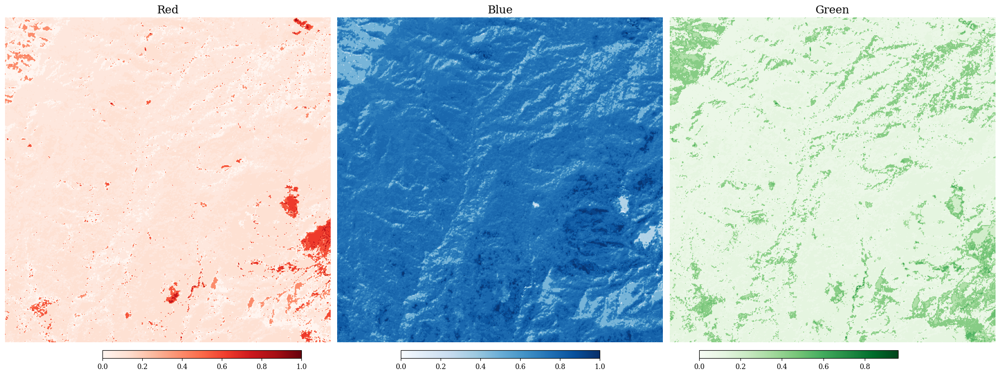

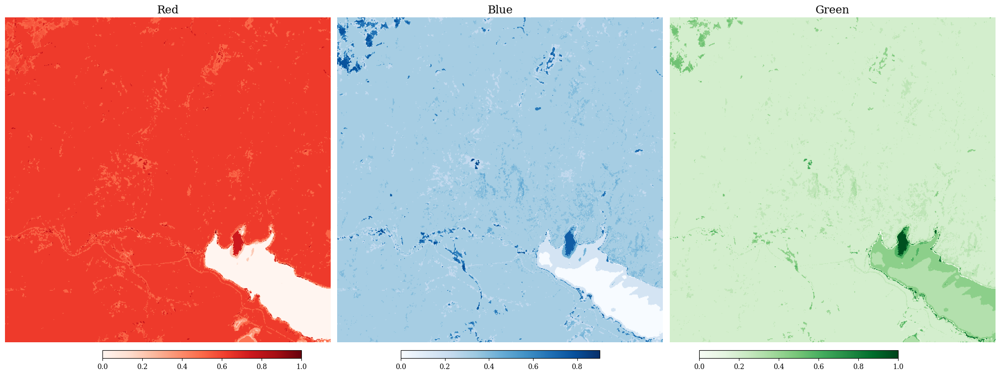

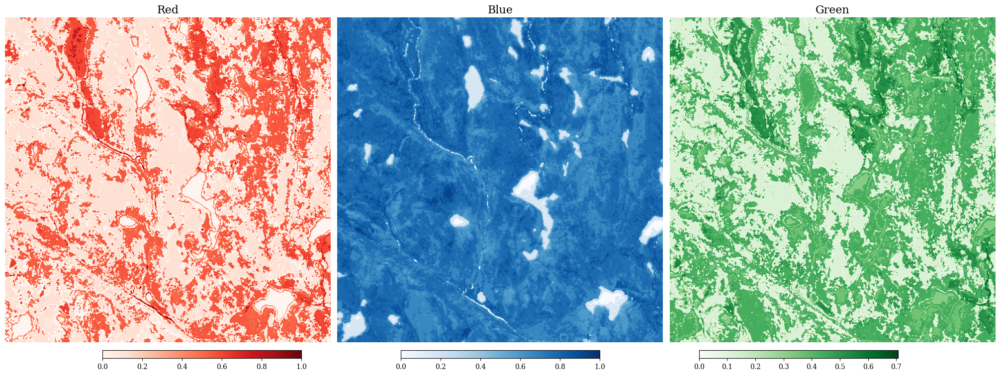

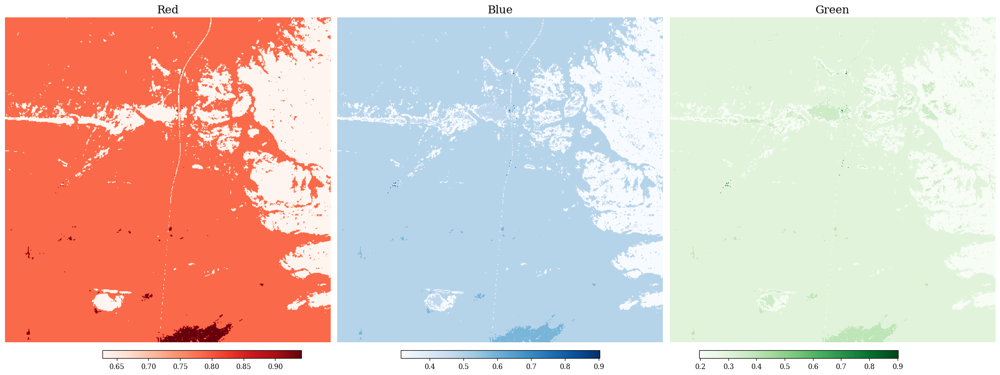

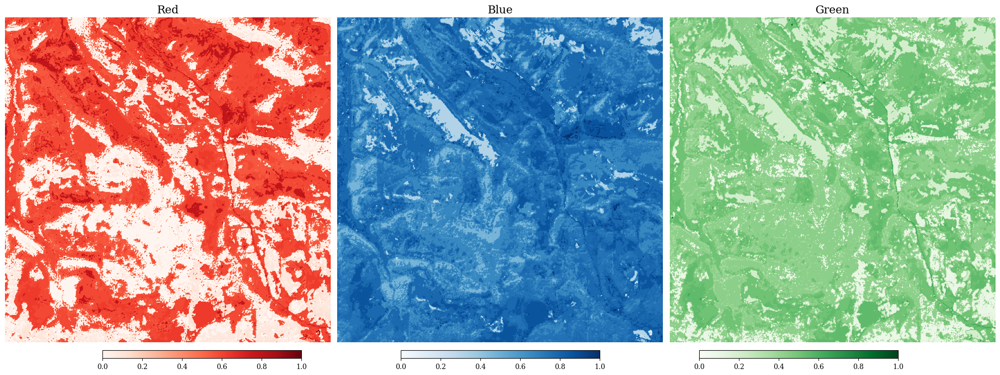

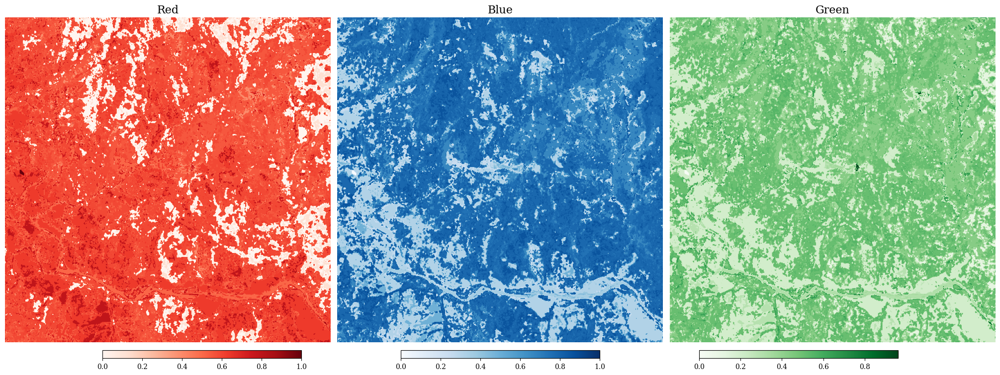

In [24]:
import numpy as np
import matplotlib.pyplot as plt

def visualize_data_v3(data, random_seed=42, batch_thresh=3):
    for batch_num, batch in enumerate(data):
        # if batch_num != batch_thresh:
        #     continue
        features, _, p_id = batch
        num_bands = features.shape[1]
        
        # Only consider the first three bands
        num_bands = min(num_bands, 3)
        
        fig, axes = plt.subplots(1, num_bands, figsize=(20, 8), constrained_layout=True)
        
        # Flatten axes array for easy iteration
        axes = axes.flatten()
        
        # randomly choose an image, label set to display
        np.random.seed(random_seed)
        idx = np.random.choice(features.shape[0])
        
        # Define colors and titles for each band
        colors = ['Reds', 'Blues', 'Greens']
        titles = ['Red', 'Blue', 'Green']
        
        # Plot bands 1, 2, 3 individually
        for i in range(num_bands):
            im = axes[i].imshow(features[idx][i,:,:], cmap=colors[i])
            axes[i].set_title(titles[i], fontsize=16)
            
            # Add a colorbar for each subplot
            cbar_ax = fig.add_axes([0.1 + i*0.3, 0.05, 0.2, 0.02])  # Adjust the position and size: [left, bottom, width, height]
            fig.colorbar(im, cax=cbar_ax, orientation='horizontal')
        
        # mute x y labels, ticks
        for ax in axes:
            ax.axis('off')
        

        if batch_num == batch_thresh:
            plt.savefig(r'E:\Thesis\outputs\00_charts\plots_transparent\batch_patch_siaminput.png', dpi=800, bbox_inches='tight', pad_inches=0.2, transparent=True)

            break
        plt.show()

# Assuming `data` is already defined
visualize_data_v3(data, random_seed=46, batch_thresh=5)


#### labels

In [ ]:
lgd_dw = 'E:\Thesis\others\legends\lgd_dw.csv'
lgd_scl = 'E:\Thesis\others\legends\lgd_scl.csv'
lgd_siam_18 = 'E:\Thesis\others\legends\lgd_siam_18.csv'
lgd_siam_33 = 'E:\Thesis\others\legends\lgd_siam_33.csv'
lgd_siam_48 = 'E:\Thesis\others\legends\lgd_siam_48.csv'
lgd_siam_96 = 'E:\Thesis\others\legends\lgd_siam_96.csv'
labelnamesorder = ['SCL', 'SIAM 18', 'SIAM 33', 'SIAM 48', 'SIAM 96', 'DW']

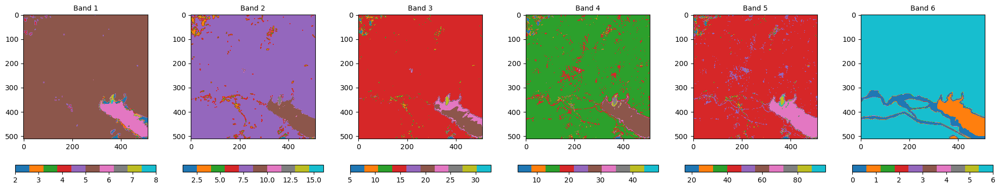

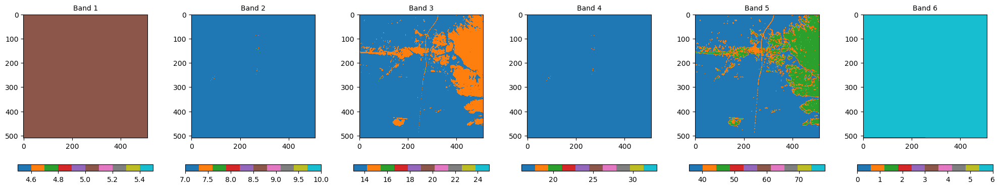

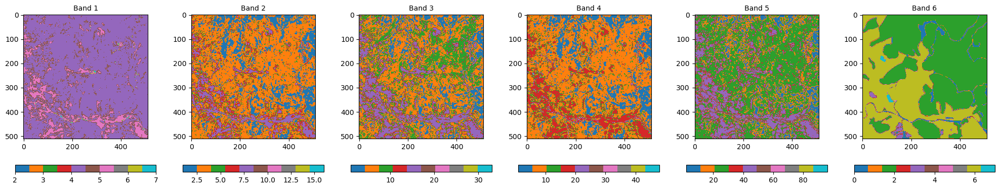

In [22]:
def visualize_labels(data, random_seed=42, batch_thresh = 3):
    for batch_num, batch in enumerate(data):
        _, labels = batch
        num_bands = labels.shape[1]

        # plot feature and label images
        fig, axes = plt.subplots(1,num_bands, figsize=(20, 4))

        # randomly choose an image,label set to display
        np.random.seed(random_seed)
        idx = np.random.choice(labels.shape[0])
        for i in range(num_bands):
            im =axes[i].imshow(labels[idx][i,:,:], cmap='tab10')
            #axes[i].set_title(feature_names[i], fontsize=10)
            axes[i].set_title(f"Band {i+1}", fontsize=10)
            sm = plt.cm.ScalarMappable(cmap='tab10')
            sm.set_array(labels[idx][i,:, :])
            cbar = fig.colorbar(im, ax=axes[i], orientation = 'horizontal')

        plt.tight_layout()
        plt.show()

        if batch_num == batch_thresh:
            break

visualize_labels(data, random_seed =46, batch_thresh = 3)

In [68]:
lgd_scl = 'E:\Thesis\others\legends\lgd_scl.csv'
lgd_siam_18 = 'E:\Thesis\others\legends\lgd_siam_18.csv'
lgd_siam_33 = 'E:\Thesis\others\legends\lgd_siam_33.csv'
lgd_siam_48 = 'E:\Thesis\others\legends\lgd_siam_48.csv'
lgd_siam_96 = 'E:\Thesis\others\legends\lgd_siam_96.csv'
lgd_dw = 'E:\Thesis\others\legends\lgd_dw.csv'

legend_paths = [lgd_scl, lgd_siam_18, lgd_siam_33, lgd_siam_48, lgd_siam_96, lgd_dw]    
labelnamesorder = ['SCL', 'SIAM 18', 'SIAM 33', 'SIAM 48', 'SIAM 96', 'DW']

In [64]:
def load_legend(legend_path):
    with open(legend_path, mode='r') as file:
        reader = csv.DictReader(file, delimiter=',')  
        rgb_dict = {}
        label_dict = {}
        for row in reader:
            #print(row)
            value = int(row['value'])
            rgb = tuple(map(int, row['rgb'][1:-1].split(',')))  # Convert "(r, g, b)" string to tuple
            rgb_dict[value] = rgb

            label = row['label']
            label_dict[value] = label
    return rgb_dict, label_dict

load_legend(lgd_scl)

({0: (0, 0, 0),
  1: (255, 0, 0),
  2: (64, 64, 64),
  3: (131, 60, 12),
  4: (0, 255, 0),
  5: (255, 255, 0),
  6: (0, 0, 204),
  7: (117, 113, 113),
  8: (174, 170, 170),
  9: (255, 255, 255),
  10: (0, 204, 255),
  11: (255, 102, 255)},
 {0: 'no data',
  1: 'saturated/defective',
  2: 'dark areas',
  3: 'cloud shadows',
  4: 'vegetation',
  5: 'not vegetated',
  6: 'water',
  7: 'unclassified',
  8: 'cloud medium prob',
  9: 'cloud high prob',
  10: 'thin cirrus',
  11: 'snow'})

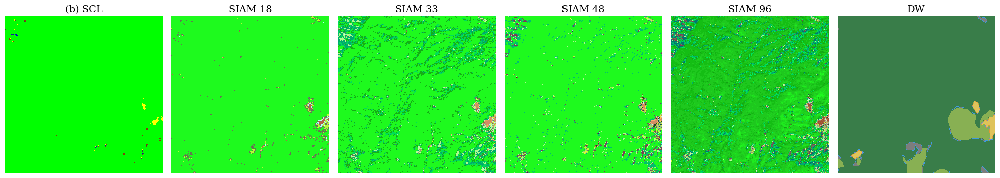

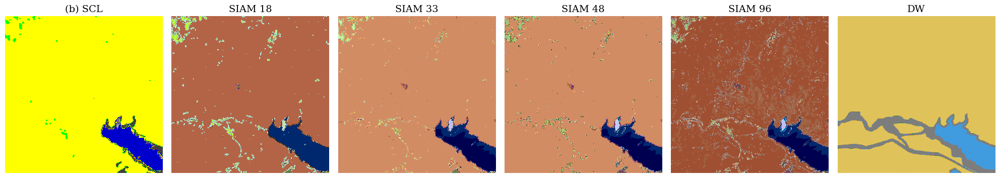

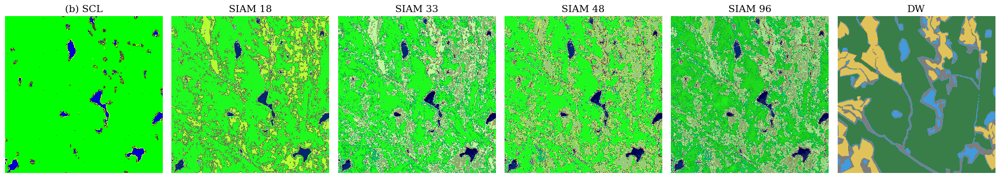

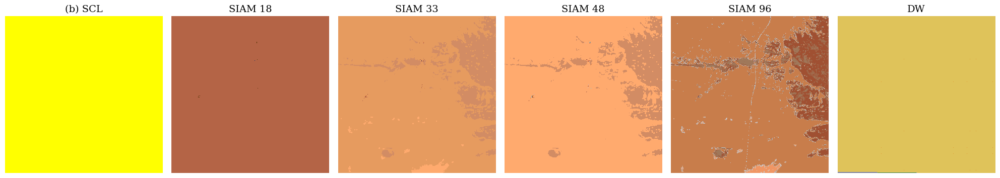

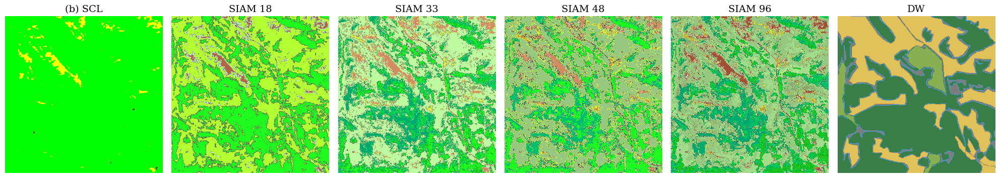

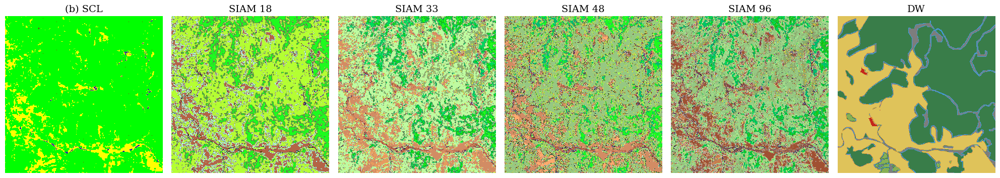

In [88]:
import numpy as np
import matplotlib.pyplot as plt
import csv

def load_legend(legend_path):
    with open(legend_path, mode='r') as file:
        reader = csv.DictReader(file, delimiter=',')  
        rgb_dict = {}
        label_dict = {}
        for row in reader:
            value = int(row['value'])
            rgb = tuple(map(int, row['rgb'][1:-1].split(',')))  # Convert "(r, g, b)" string to tuple
            rgb_dict[value] = rgb

            label = row['label']
            label_dict[value] = label
    return rgb_dict, label_dict

def create_colormap(color_legend):
    cmap = plt.cm.colors.ListedColormap([np.array(color_legend[i]) / 255 for i in color_legend.keys()])
    bounds = list(color_legend.keys())
    norm = plt.cm.colors.BoundaryNorm(bounds, cmap.N)
    return cmap, norm

def visualize_labels(data, legend_paths, random_seed=42, batch_thresh=3, labelnamesorder=None):
    legends = [load_legend(path) for path in legend_paths]
    cmaps_norms = [create_colormap(legend[0]) for legend in legends]

    for batch_num, batch in enumerate(data):
        _, labels, _ = batch
        num_bands = labels.shape[1]

        # plot feature and label images
        fig, axes = plt.subplots(1, num_bands, figsize=(20, 8))

        # randomly choose an image, label set to display
        np.random.seed(random_seed)
        idx = np.random.choice(labels.shape[0])
        for i in range(num_bands):
            cmap, norm = cmaps_norms[i]
            im = axes[i].imshow(labels[idx][i, :, :], cmap=cmap, norm=norm)
            if i == 0:
                axes[i].set_title(f"(b) {labelnamesorder[i]}", fontsize=14)
            else:
                axes[i].set_title(f"{labelnamesorder[i]}", fontsize=14)
            axes[i].axis('off')

        plt.savefig(r'E:\Thesis\outputs\00_charts\plots\batch_patch_labels.png', dpi=1080, bbox_inches='tight', pad_inches=0.2)
        plt.tight_layout()
        plt.show()

        if batch_num == batch_thresh:
            break

# Example usage
# Replace `legend_paths` with the actual paths to your CSV legend files
# Ensure `labelnamesorder` is defined and contains appropriate labels for each band
visualize_labels(data, legend_paths=legend_paths, random_seed=46, batch_thresh=5, labelnamesorder=labelnamesorder)


In [56]:
lgd_dw

,value,abbrev,label,rgb,RGB
0,0,na,No data (left unmarked),"(125, 125, 125)","(125, 125, 125)"
1,1,wat,Water,"(65, 155, 223)","(65, 155, 223)"
2,2,tree,Trees,"(57, 125, 73)","(57, 125, 73)"
3,3,gras,Grass,"(136, 176, 83)","(136, 176, 83)"
4,4,flood,Flooded Vegetation,"(122, 135, 198)","(122, 135, 198)"
5,5,crop,Crops,"(228, 150, 53)","(228, 150, 53)"
6,6,scrub,Scrub,"(223, 195, 90)","(223, 195, 90)"
7,7,built,Built Area,"(196, 40, 27)","(196, 40, 27)"
8,8,bare,Bare Ground,"(165, 155, 143)","(165, 155, 143)"
9,9,snow,Snow/Ice,"(179, 159, 225)","(179, 159, 225)"


In [2]:
# modifying class to have only one band in label
class TestClass(Dataset):
    def __init__(self, data_path, metadata, set, learn_type, process_level, lis_files=None, transform=None):
    # in metadata dataframe, select patches with set as train 
        self.data_path = data_path
        self.set = set
        self.transform = transform
        self.process_level = process_level
        self.learn_type = learn_type
        self.metadata = metadata
        self.metadata_set = self.metadata[(self.metadata['set']==self.set) & (self.metadata['learn_type']==self.learn_type)]
        if lis_files:
            self.metadata_set = self.metadata_set[self.metadata_set['patch_id'].isin(lis_files)]

    def __len__(self):
        return len(self.metadata_set)

    def __getitem__(self, idx):
        # return tensor pair feature,label
        feat_fname= (f"{self.process_level}_"
                      f"{self.learn_type}_"
                      f"{self.metadata_set.iloc[idx, 0]}_"
                      f"feats.tif")
        label_fname= (f"{self.process_level}_"
                      f"{self.learn_type}_"
                      f"{self.metadata_set.iloc[idx, 0]}_"
                      f"label.tif")

        feat_p = os.path.join(self.data_path, feat_fname)
        label_p = os.path.join(self.data_path, label_fname)
        
        with rio.open(feat_p) as src:
            feat = src.read().astype(np.int16)
        with rio.open(label_p) as src:
            label = src.read().astype(np.int16)

        # handle dtypes for tensor
        feat = torch.from_numpy(feat).to(torch.float32)
        label = torch.from_numpy(label).to(torch.float32)
        # if self.transform:
        #     feat = self.transform(feat)
            # label = self.transform(label)
        return feat, label[5,:,:].long()

## 2. Train-Val Folds preparation

#### 2.1. Entire dataset

In [1]:
import os
import numpy as np
import pandas as pd
from torch.utils.data import Dataset, DataLoader
from torchvision.transforms import Compose, Normalize
import torch
from torchsummary import summary

from sklearn.model_selection import train_test_split, StratifiedKFold
import random
from PIL import Image
import cv2
import rasterio as rio
import matplotlib.pyplot as plt
import time
from tqdm import tqdm

In [55]:
# for ssl splits
def generate_kfold_IDs_updated(metadata, out_path , learn_type, split, k=3, random_seed=42):
    
    print("Total patches available",len(metadata))
    print("Total patches available for CSL train",len(metadata[(metadata['set']=='train') & (metadata['learn_type']=='csl')]))
    print("Total patches available for CSL test", len(metadata[(metadata['set']=='test') & (metadata['learn_type']=='csl')]))
    print("Total patches available for SSL train",len(metadata[(metadata['set']=='train') & (metadata['learn_type']=='ssl')]))

    print(f"\nPerforming splitting for >>{learn_type}<< task on >>{split}<<set\n")
    
    metadata_set = metadata[(metadata['set']==split) & (metadata['learn_type']==learn_type)]
    if metadata_set['biome_id'].isnull().sum() > 0:
        print("Biome ID has NaNs, assigning -999 as NaN class label")
        classes = metadata_set['biome_id'].fillna(-999)   # fillna to handle NaNs at the splitting step

    else:
        classes = metadata_set['biome_id']
        
    print("Biome class hist",np.unique(classes, return_counts=True))
    skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=random_seed)
    splits =skf.split(metadata_set, classes)  
    
    # ensure to have same number of elements in each split
    train_len = max([len(train_indices) for train_indices,_ in splits]) # get max train lengths among all splits
    print("Max train length among splits", train_len)
    #val_len = remaining 
    
    #get patch Ids from the split indices and save as pickle
    for i, (train_indices, val_indices) in enumerate(skf.split(metadata_set, classes)):
        train_files = metadata_set.iloc[train_indices]['patch_id']
        val_files = metadata_set.iloc[val_indices]['patch_id']

        print("\nBefore adjusting lengths", len(train_files), len(val_files))

        if k==3: # for 'small' dataset. for toy, go with k=2 and skip this step
            if len(train_files) <train_len:
                add_file = val_files.sample(1, random_state=random_seed)
                train_files = pd.concat([train_files, add_file])
                val_files = val_files.drop(add_file.index)
        print("After adjusting lengths",len(train_files), len(val_files))

        train_files.to_pickle(os.path.join(out_path, f"{learn_type}_train_files_{i}.pkl"))
        val_files.to_pickle(os.path.join(out_path, f"{learn_type}_val_files_{i}.pkl"))
    return splits 

In [44]:
# toy
out_path = r"D:\Projects_Github\semantic-enrichment-for-semantic-image-segmentation\notebooks\toy_fold_splits"
meta_path =  r"E:\Thesis\toy\meta_patches.csv"
metadata = pd.read_csv(meta_path)

In [26]:
# small
out_path = r"D:\Projects_Github\semantic-enrichment-for-semantic-image-segmentation\split_folds"
meta_path =  r"E:\Thesis\data\small\meta_patches.csv"
metadata = pd.read_csv(meta_path)

In [56]:
learn_type= 'csl'
split= 'train'
k=3
splits = generate_kfold_IDs_updated(metadata=metadata, out_path =out_path, learn_type=learn_type, 
                                    split = split, k=k, random_seed=42)

Total patches available 6081
Total patches available for CSL train 2102
Total patches available for CSL test 378
Total patches available for SSL train 3601

Performing splitting for >>csl<< task on >>train<<set

Biome class hist (array([ 1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12., 13.,
       14.]), array([163, 153, 102, 146, 147, 158, 163, 164, 153, 153, 139, 163, 149,
       149], dtype=int64))
Max train length among splits 1402

Before adjusting lengths 1401 701
After adjusting lengths 1402 700

Before adjusting lengths 1401 701
After adjusting lengths 1402 700

Before adjusting lengths 1402 700
After adjusting lengths 1402 700


In [57]:
learn_type= 'ssl'
split= 'train'
k=3
splits = generate_kfold_IDs_updated(metadata=metadata, out_path =out_path, learn_type=learn_type, 
                                    split = split, k=k, random_seed=42)

Total patches available 6081
Total patches available for CSL train 2102
Total patches available for CSL test 378
Total patches available for SSL train 3601

Performing splitting for >>ssl<< task on >>train<<set

Biome ID has NaNs, assigning -999 as NaN class label
Biome class hist (array([-999.,    1.,    2.,    3.,    4.,    5.,    6.,    7.,    8.,
          9.,   10.,   11.,   12.,   13.,   14.]), array([264, 414, 217,  84, 343, 221, 321, 377, 274, 149, 183, 165, 215,
       328,  46], dtype=int64))
Max train length among splits 2401

Before adjusting lengths 2400 1201
After adjusting lengths 2401 1200

Before adjusting lengths 2401 1200
After adjusting lengths 2401 1200

Before adjusting lengths 2401 1200
After adjusting lengths 2401 1200


In [35]:
fold0 = pd.read_pickle(os.path.join(out_path, f"csl_train_files_0.pkl"))
len(fold0)

1681

#### 2.2 Subset Train-val folds to 10%, 25%, 50% subsets

In [2]:
import os
import pandas as pd
from sklearn.model_selection import train_test_split
import numpy as np

def load_fold(fold_path):
    fold = pd.read_pickle(fold_path)
    return fold

def handle_nans(metadata_set):
    if metadata_set['biome_id'].isnull().sum() > 0:
        print("Biome ID has NaNs, assigning -999 as NaN class label")
        classes = metadata_set['biome_id'].fillna(-999)   # fillna to handle NaNs at the splitting step
    else:
        classes = metadata_set['biome_id']
    return classes

def generate_kfold_IDs_updated(fold_path, metadata, out_path, fold_type, fold, subset_splits=[0.25, 0.5], random_seed=42):
    fold_file_path = os.path.join(fold_path, f"csl_{fold_type}_files_{str(fold)}.pkl")
    fold_pkl = load_fold(fold_file_path)
    
    metadata_set = metadata[(metadata['set'] == 'train') & (metadata['learn_type'] == 'csl')]
    metadata_set = metadata_set[metadata_set['patch_id'].isin(fold_pkl)]
    
    classes = handle_nans(metadata_set)
    
    print(f"\nPerforming splitting for fold {fold} ({fold_file_path}) \n")
    for i in subset_splits:
        subset, _ = train_test_split(metadata_set, train_size=i, stratify=classes, random_state=random_seed)
        split_files = subset['patch_id']
        
        proportion = int(i*100)
        output_file_path = os.path.join(out_path, f"csl_{fold_type}_files_{fold}_{proportion}.pkl")
        split_files.to_pickle(output_file_path)
        
        # Verification step
        loaded_split_files = pd.read_pickle(output_file_path)
        if len(loaded_split_files) != len(split_files):
            print(f"Error: Mismatch in lengths for {output_file_path}. Saved length: {len(split_files)}, Loaded length: {len(loaded_split_files)}")
        else:
            print(f"Successfully saved and verified {output_file_path} with {len(split_files)} entries.")


In [3]:
path = r'D:\Projects_Github\semantic-enrichment-for-semantic-image-segmentation\split_folds'
out_path = r'D:\Projects_Github\semantic-enrichment-for-semantic-image-segmentation\split_folds'
meta_path =  r"E:\Thesis\data\small\meta_patches.csv"
metadata = pd.read_csv(meta_path)

# for train patches 
for i in range(3):
    generate_kfold_IDs_updated(fold_path=path, metadata=metadata, out_path =out_path, fold_type='train',
                            fold=i, subset_splits = [0.25, 0.5, 0.1], random_seed=42)



Performing splitting for fold 0 (D:\Projects_Github\semantic-enrichment-for-semantic-image-segmentation\split_folds\csl_train_files_0.pkl) 

Successfully saved and verified D:\Projects_Github\semantic-enrichment-for-semantic-image-segmentation\split_folds\csl_train_files_0_25.pkl with 350 entries.
Successfully saved and verified D:\Projects_Github\semantic-enrichment-for-semantic-image-segmentation\split_folds\csl_train_files_0_50.pkl with 701 entries.
Successfully saved and verified D:\Projects_Github\semantic-enrichment-for-semantic-image-segmentation\split_folds\csl_train_files_0_10.pkl with 140 entries.

Performing splitting for fold 1 (D:\Projects_Github\semantic-enrichment-for-semantic-image-segmentation\split_folds\csl_train_files_1.pkl) 

Successfully saved and verified D:\Projects_Github\semantic-enrichment-for-semantic-image-segmentation\split_folds\csl_train_files_1_25.pkl with 350 entries.
Successfully saved and verified D:\Projects_Github\semantic-enrichment-for-semantic-

In [4]:
# for val patches
path = r'D:\Projects_Github\semantic-enrichment-for-semantic-image-segmentation\split_folds'
out_path = r'D:\Projects_Github\semantic-enrichment-for-semantic-image-segmentation\split_folds'
meta_path =  r"E:\Thesis\data\small\meta_patches.csv"
metadata = pd.read_csv(meta_path)

# for train patches 
for i in range(3):
    generate_kfold_IDs_updated(fold_path=path, metadata=metadata, out_path =out_path, fold_type='val',
                            fold=i, subset_splits = [0.25, 0.5,0.1], random_seed=42)



Performing splitting for fold 0 (D:\Projects_Github\semantic-enrichment-for-semantic-image-segmentation\split_folds\csl_val_files_0.pkl) 

Successfully saved and verified D:\Projects_Github\semantic-enrichment-for-semantic-image-segmentation\split_folds\csl_val_files_0_25.pkl with 175 entries.
Successfully saved and verified D:\Projects_Github\semantic-enrichment-for-semantic-image-segmentation\split_folds\csl_val_files_0_50.pkl with 350 entries.
Successfully saved and verified D:\Projects_Github\semantic-enrichment-for-semantic-image-segmentation\split_folds\csl_val_files_0_10.pkl with 70 entries.

Performing splitting for fold 1 (D:\Projects_Github\semantic-enrichment-for-semantic-image-segmentation\split_folds\csl_val_files_1.pkl) 

Successfully saved and verified D:\Projects_Github\semantic-enrichment-for-semantic-image-segmentation\split_folds\csl_val_files_1_25.pkl with 175 entries.
Successfully saved and verified D:\Projects_Github\semantic-enrichment-for-semantic-image-segment

In [73]:
pkl = pd.read_pickle(r"D:\Projects_Github\semantic-enrichment-for-semantic-image-segmentation\split_folds\csl_train_files_0_25.pkl")
len(pkl)

350